In [1]:
import numpy as np
import pandas as pd
from scipy import stats as ss
import seaborn as sns
import sklearn
from matplotlib import pyplot as plt
from sklearn.linear_model import LogisticRegression, LinearRegression
sns.set_style('darkgrid')

In [2]:
data = pd.read_csv("../data/dataman-udit-cars-data/Cars_Data")
data = data.dropna()
data

,car,model_year,country,mileage,no_of_cylinders,displacement,hp,weight,acceleration,price
0,chevrolet chevelle malibu,1970,USA,18.0,8,307.0,130.0,3504,12.0,25561.59078
1,buick skylark 320,1970,USA,15.0,8,350.0,165.0,3693,11.5,24221.42273
2,plymouth satellite,1970,USA,18.0,8,318.0,150.0,3436,11.0,27240.84373
3,amc rebel sst,1970,USA,16.0,8,304.0,150.0,3433,12.0,33684.96888
4,ford torino,1970,USA,17.0,8,302.0,140.0,3449,10.5,20000.00000
...,...,...,...,...,...,...,...,...,...,...
393,ford mustang gl,1982,USA,27.0,4,140.0,86.0,2790,15.6,13432.50000
394,vw pickup,1982,Europe,44.0,4,97.0,52.0,2130,24.6,37000.00000
395,dodge rampage,1982,USA,32.0,4,135.0,84.0,2295,11.6,47800.00000
396,ford ranger,1982,USA,28.0,4,120.0,79.0,2625,18.6,46000.00000


In [3]:
from sklearn.preprocessing import OneHotEncoder, StandardScaler, LabelBinarizer
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split
from sklearn.compose import ColumnTransformer


In [4]:
useful_cols = [ 'model_year', 'country', 'mileage', 'no_of_cylinders'
              , 'displacement', 'hp', 'weight', 'acceleration', 'price'
              ]
ys_col = 'no_of_cylinders'
categorical_features = ['model_year', 'country', 'no_of_cylinders']
numeric_features = ['mileage', 'displacement', 'hp', 'weight', 'acceleration', 'price']

xs = data[[x for x in useful_cols if x != ys_col]]
ys = data[[ys_col]]

In [5]:
numeric_transformer = StandardScaler()
categorical_transformer = OneHotEncoder(handle_unknown='ignore')

preproc = ColumnTransformer(
    transformers = [ ("num", numeric_transformer, numeric_features)
                   , ("cat", categorical_transformer, [x for x in categorical_features if x != ys_col])
                   ]
)

pipe = Pipeline(steps=[ ("preprocessor", preproc)
                      , ("classifier", LogisticRegression( fit_intercept=False))
                      ]
               )

In [6]:
def show_predict(pipe, x_test, y_test, ys_col):
    print('score:', str(pipe.score(x_test, y_test)))
    return pd.DataFrame( pipe.predict(x_test)
                       , index=x_test.index
                       , columns=['predicted_'+ys_col],
                       ).join(x_test).join(y_test)


In [7]:
def get_epv(df):
    v = len(df.columns)
    e = len(df)
    return e/v

def get_lr_coef(pipe, intercept=False):
    if intercept:
        c = pipe.steps[-1][1].coef_
        i = pipe.steps[-1][1].intercept_[0]
        return np.array(np.array([cc for cc in c.flatten()] + [i]))
    else:
        return pipe.steps[-1][1].coef_

def set_lr_coef(pipe, coef, intercept=False):
    if intercept:
        for c in range(len(coef) - 1):
            pipe.steps[-1][1].coef_[0,c] = coef[c]
        pipe.steps[-1][1].intercept_[0] = coef[-1]
    else:
        pipe.steps[-1][1].coef_ = coef

    
def fit_lr_only(pipe, xs, ys):
    transformed_xs = pipe.steps[0][1].transform(xs)
    pipe.steps[-1][1].fit(transformed_xs, ys)

In [114]:
def trial(xs, ys, target_epv, lr_pipe, intercept=False, output_as_df=False, alpha_star=None, trial_num=None):
    
    # create population & hold-out test set
    pop_x, test_x, pop_y, test_y = train_test_split(xs, ys)
    
    # create sample size based on target_epv
    num_vars = len(xs.columns)
    sample_size = int(np.round(target_epv * num_vars))

    # create sample
    pop_ind = pop_x.index
    sample_ind = np.random.choice( pop_x.index
                                 , size=sample_size
                                 , replace=False
                                 )    
    sample_x = pop_x.loc[sample_ind]
    sample_y = pop_y.loc[sample_ind]
    
    # fit population
    lr_pipe.fit( pop_x
               , pop_y.values.ravel()
               )
    pop_coef = get_lr_coef(lr_pipe, intercept)
    pop_score = lr_pipe.score(test_x, test_y)
    
    xprime = lr_pipe[0].transform(pop_x)
    
    if intercept:
        intercept_col = np.ones((len(pop_x), 1))
    else:
        intercept_col = np.zeros((len(pop_x), 1))
    
    
    xprime = np.hstack((xprime, intercept_col))
    
    pop_signal_strength = np.sqrt(np.var(xprime @ pop_coef))
    
    # safety valve for these small sample sizes
    safety_valve = len(sample_y[sample_y.columns[0]].unique()) < 2
    while safety_valve:
        sample_ind = np.random.choice( pop_x.index
                             , size=sample_size
                             , replace=False
                             )    
        sample_x = pop_x.loc[sample_ind]
        sample_y = pop_y.loc[sample_ind]
        safety_valve = len(sample_y[sample_y.columns[0]].unique()) < 2
        
    # don't do the transform steps again for the shorter lists
    fit_lr_only(lr_pipe, sample_x, sample_y.values.ravel())
    sample_coef = get_lr_coef(lr_pipe, intercept)
    sample_score = lr_pipe.score(test_x, test_y)
    
    xprime = lr_pipe[0].transform(sample_x)
    
    sample_signal_strength = np.sqrt(np.var(xprime @ pop_coef[:-1]))
    
    results = { "population_coeff" : pop_coef
              , "population_score" : pop_score
              , "population_epv" : get_epv(pop_x) #len(pop_x) * 1./len(pop_coef.flatten())
              , "population_signal_strength" : pop_signal_strength 
              , "sample_coeff" : sample_coef
              , "sample_score" : sample_score
              , "sample_epv" : get_epv(sample_x) #len(sample_x) * 1./len(pop_coef.flatten())
              , "sample_signal_strength" : sample_signal_strength 
              }
    
    if output_as_df:
        results['population_coeff'] = pop_coef.flatten()
        results['sample_coeff'] = sample_coef.flatten()
        results = pd.DataFrame(results)
        results['coeff_ind'] = np.arange(0, len(results))
        
        if alpha_star is not None:
            if len(alpha_star) != len(sample_coef.flatten()):
                print('could not continue with alpha_star correction, length mismatch')
                return results
            else:
                
                if not intercept:
                    new_sample_coef = np.array([
                        sample_coef[0,i] / alpha_star[i] for i in range(len(alpha_star))
                    ]).reshape(sample_coef.shape)

                    set_lr_coef(lr_pipe, new_sample_coef, intercept=intercept)
                else:
                    new_sample_coef = np.array([
                        sample_coef[i] / alpha_star[i] for i in range(len(alpha_star))
                    ])
                    
                    set_lr_coef(lr_pipe, new_sample_coef, intercept=intercept)
                
                corrected_score = lr_pipe.score(test_x, test_y)
                results['corrected_coeff'] = new_sample_coef.flatten()
                results['corrected_score'] = corrected_score    
                
    if trial_num is not None:
        results['trial_num'] = trial_num
    
    return results

def experiment(n_trials, target_epv, xs, ys, pipeline, seed=None, intercept=False):
    if seed is not None:
        np.random.seed(seed)
        
    # generate
    results = pd.concat([ trial(xs
                               , ys
                               , target_epv
                               , pipeline
                               , intercept=intercept
                               , output_as_df=True
                               , trial_num=n 
                               ) 
                         for n in range(n_trials) 
                        ]).reset_index(drop=True)
    
    
    # analysis
    alpha_star = np.zeros(len(results['coeff_ind'].unique()))
    for coeff, ind_df in results.groupby('coeff_ind'):
        # working space df
        df = ind_df.copy()

        # plot population vs sample beta
        sns.regplot( data=ind_df
                 , x='population_coeff'
                 , y='sample_coeff'
                 )
        plt.show()

        linreg = LinearRegression( fit_intercept=False
                                 ).fit( ind_df['population_coeff'].values.reshape(-1, 1)
                                      , ind_df['sample_coeff'].values
                                      )
        alpha_star[coeff] = linreg.coef_[0]

        df['bias'] = df['sample_coeff'] - df['population_coeff']
        df['correction'] = df['sample_coeff'] - alpha_star[coeff] * df['population_coeff']

        d1 = df.copy()
        d1['corrected'] = False
        d2 = df.copy()
        d2['corrected'] = True
        d2['bias'] = d2['correction']
        df_j = pd.concat([ d1
                         , d2
                         ]
                        , axis=0
                        ).drop(columns=['correction']
                              ).reset_index()

        sns.histplot(data=df_j
                    , x='bias'
                    , hue='corrected'
                    , palette=['red', 'skyblue'] 
                    )
        plt.show()

        sns.jointplot( data=df_j
                     , x='population_coeff'
                     , y='bias'
                     , hue='corrected'
                     , palette=['red', 'skyblue'] 
                     )
        plt.savefig(fname='joint_bias_corr_'+str(coeff)+'.png')
        plt.show()
            
    
    return results, alpha_star

def correction_experiment(n_trials, target_epv, xs, ys, pipeline, alpha_star, intercept=False, seed=None):
    if seed is not None:
        np.random.seed(seed)
        
    results = pd.concat([ trial(xs
                               , ys
                               , target_epv
                               , pipeline
                               , intercept=intercept 
                               , output_as_df=True
                               , alpha_star=alpha_star 
                               , trial_num=n 
                               ) 
                         for n in range(n_trials) 
                        ]).reset_index(drop=True)
    
    result_gb = results.groupby('trial_num').aggregate('mean')[
        ['population_score', 'sample_score', 'corrected_score']
    ]
    
    sns.histplot(data=result_gb, x='population_score', color='blue', label='Population', bins='fd', kde=True)
    sns.histplot(data=result_gb, x='sample_score', color='red', label='Biased Sample', bins='fd', kde=True)
    sns.histplot(data=result_gb, x='corrected_score', color='skyblue', label='Corrected Sample', bins='fd', kde=True)
    plt.xlabel('score')
    plt.legend()
    plt.show()

    return results

# Simplify classes to binary i.e. <= 4 & >4

This creates reasonably balanced classes and leaves us with only 22ish coefficients in our logistic model

<AxesSubplot:xlabel='no_of_cylinders', ylabel='Count'>

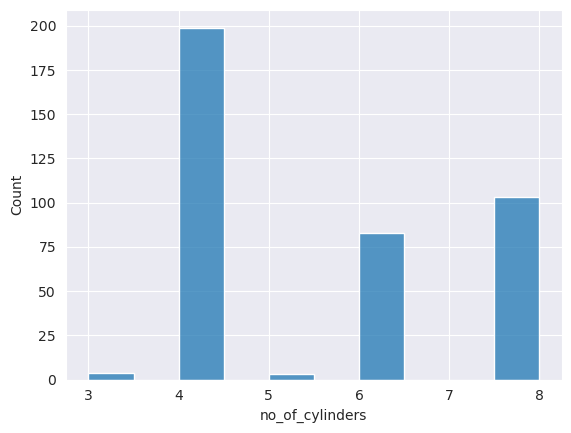

In [9]:
sns.histplot(data=data, x=ys_col)

In [11]:
new_data = data.copy()
new_data['more_than_4_cylinders'] = (data['no_of_cylinders'] > 4).astype(int)
new_data = new_data.drop(columns=['no_of_cylinders'])
new_data

,car,model_year,country,mileage,displacement,hp,weight,acceleration,price,more_than_4_cylinders
0,chevrolet chevelle malibu,1970,USA,18.0,307.0,130.0,3504,12.0,25561.59078,1
1,buick skylark 320,1970,USA,15.0,350.0,165.0,3693,11.5,24221.42273,1
2,plymouth satellite,1970,USA,18.0,318.0,150.0,3436,11.0,27240.84373,1
3,amc rebel sst,1970,USA,16.0,304.0,150.0,3433,12.0,33684.96888,1
4,ford torino,1970,USA,17.0,302.0,140.0,3449,10.5,20000.00000,1
...,...,...,...,...,...,...,...,...,...,...
393,ford mustang gl,1982,USA,27.0,140.0,86.0,2790,15.6,13432.50000,0
394,vw pickup,1982,Europe,44.0,97.0,52.0,2130,24.6,37000.00000,0
395,dodge rampage,1982,USA,32.0,135.0,84.0,2295,11.6,47800.00000,0
396,ford ranger,1982,USA,28.0,120.0,79.0,2625,18.6,46000.00000,0


In [15]:
useful_cols = [ 'model_year', 'country', 'mileage', 'more_than_4_cylinders'
              , 'displacement', 'hp', 'weight', 'acceleration', 'price'
              ]
ys_col = 'more_than_4_cylinders'
categorical_features = ['model_year', 'country', 'more_than_4_cylinders']
numeric_features = ['mileage', 'displacement', 'hp', 'weight', 'acceleration', 'price']

xs = new_data[[x for x in useful_cols if x != ys_col]]
ys = new_data[[ys_col]]

numeric_transformer = StandardScaler()
categorical_transformer = OneHotEncoder(handle_unknown='ignore')

preproc = ColumnTransformer(
    transformers = [ ("num", numeric_transformer, numeric_features)
                   , ("cat", categorical_transformer, [x for x in categorical_features if x != ys_col])
                   ]
)

new_pipe = Pipeline(steps=[ ("preprocessor", preproc)
                          , ("classifier", LogisticRegression( fit_intercept=False))
                          ]
                   )

pipe_int = Pipeline(steps=[ ("preprocessor", preproc)
                          , ("classifier", LogisticRegression( fit_intercept=True))
                          ]
                   )

<AxesSubplot:xlabel='more_than_4_cylinders', ylabel='Count'>

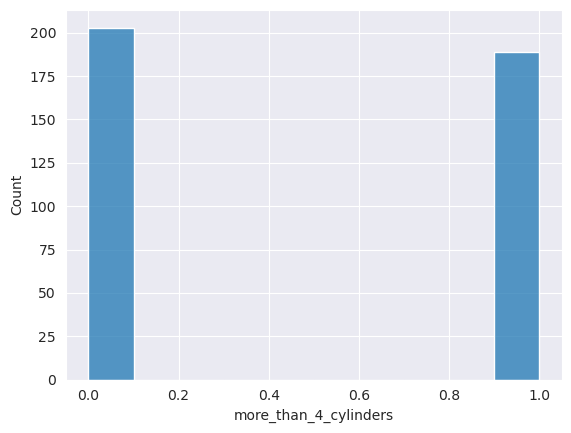

In [14]:
sns.histplot(data=new_data, x=ys_col)

In [113]:
res = trial(xs, ys, 5, pipe_int, output_as_df=True, intercept=True,)
res

,population_coeff,population_score,population_epv,population_signal_strength,sample_coeff,sample_score,sample_epv,sample_signal_strength,coeff_ind
0,-0.532150,0.979592,36.75,7.405253,-0.711883,0.94898,5.0,7.521513,0
1,3.459597,0.979592,36.75,7.405253,1.340295,0.94898,5.0,7.521513,1
2,1.087321,0.979592,36.75,7.405253,1.121167,0.94898,5.0,7.521513,2
3,2.241241,0.979592,36.75,7.405253,1.038022,0.94898,5.0,7.521513,3
4,-0.440846,0.979592,36.75,7.405253,-0.502181,0.94898,5.0,7.521513,4
5,0.245002,0.979592,36.75,7.405253,0.304532,0.94898,5.0,7.521513,5
6,0.432793,0.979592,36.75,7.405253,0.006080,0.94898,5.0,7.521513,6
7,-0.058197,0.979592,36.75,7.405253,0.127242,0.94898,5.0,7.521513,7
8,-0.273553,0.979592,36.75,7.405253,-0.142252,0.94898,5.0,7.521513,8
9,0.396967,0.979592,36.75,7.405253,0.127690,0.94898,5.0,7.521513,9


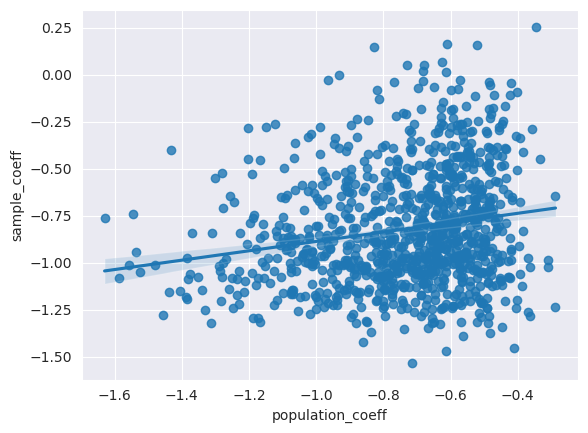

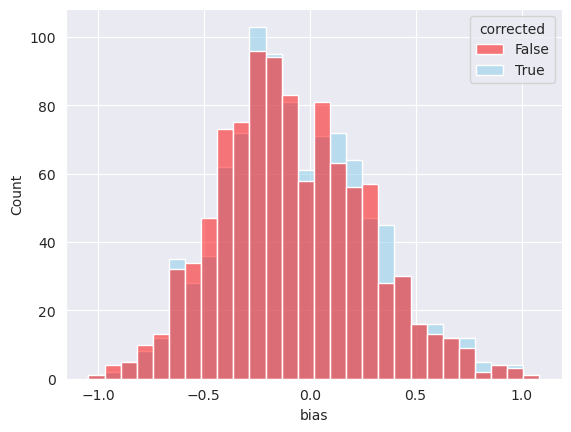

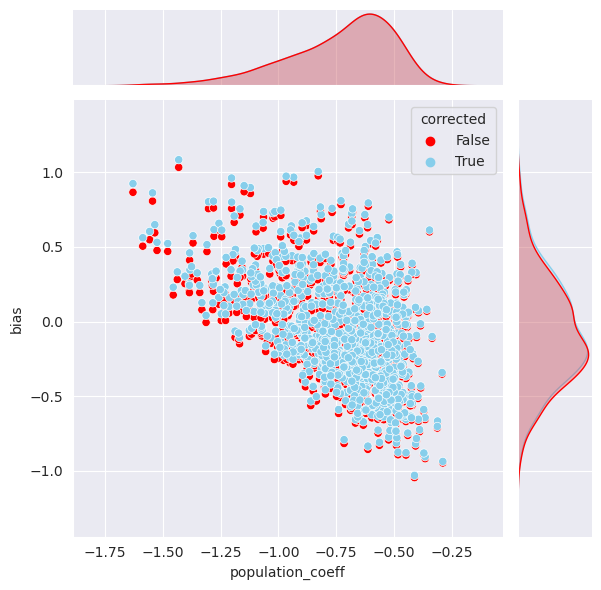

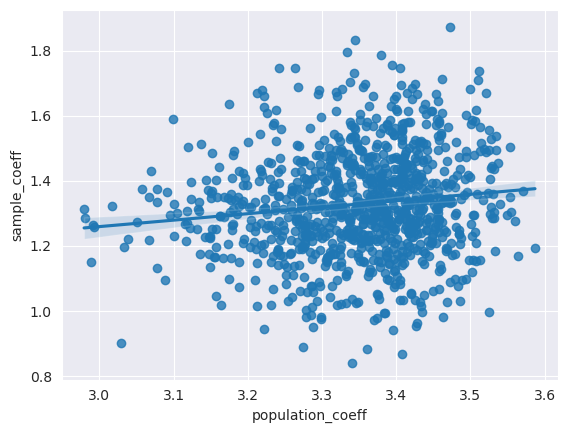

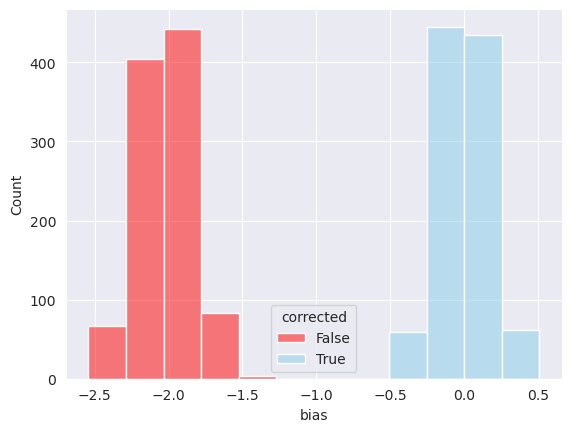

...

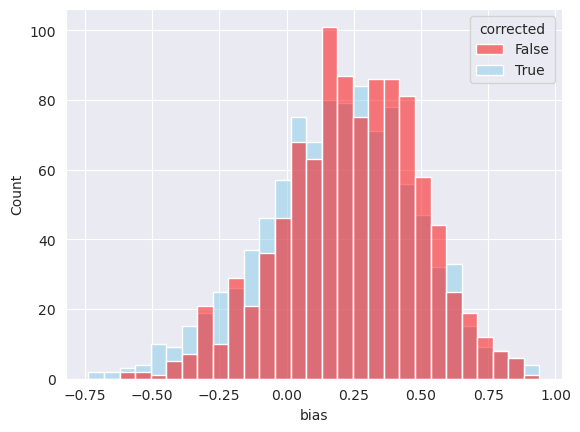

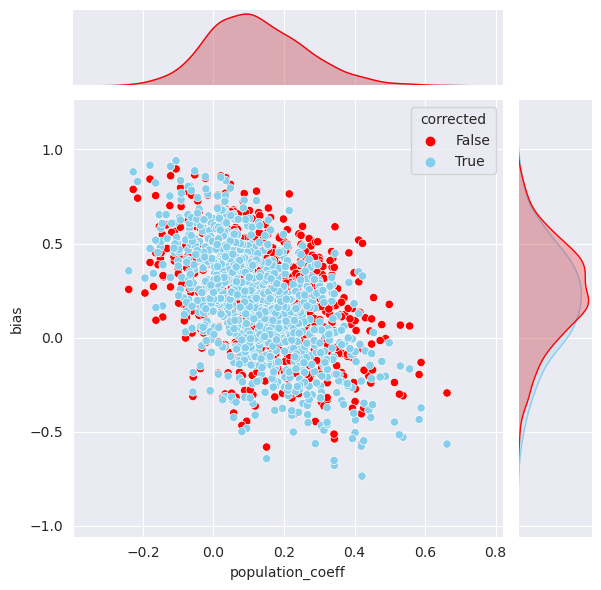

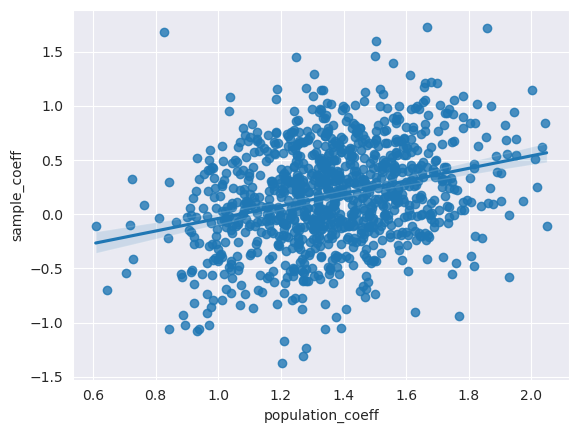

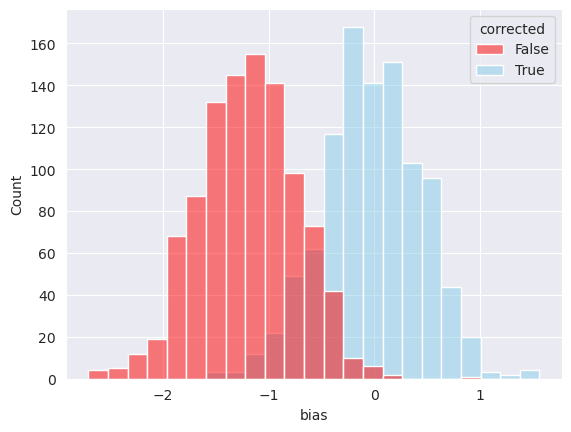

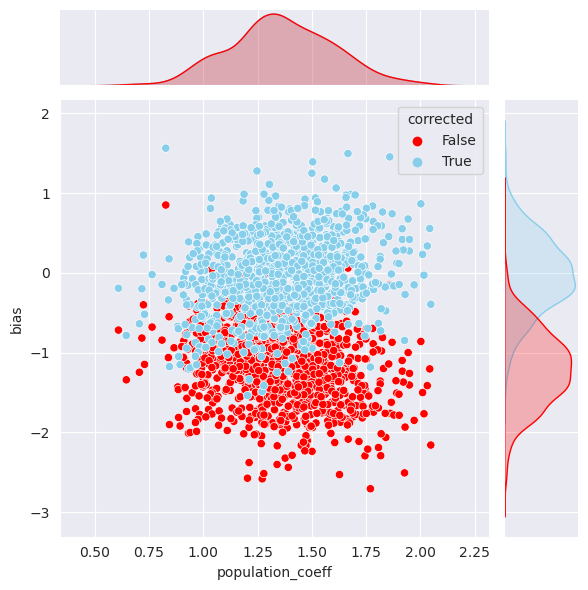

In [116]:
df, alpha_star = experiment(1000, 5.0, xs, ys, pipe_int, seed=12345, intercept=True,)

In [117]:
# res = trial(xs, ys, 5, pipe_int, output_as_df=True, alpha_star=alpha_star,intercept=True,)
# res['alpha*'] = alpha_star
# res

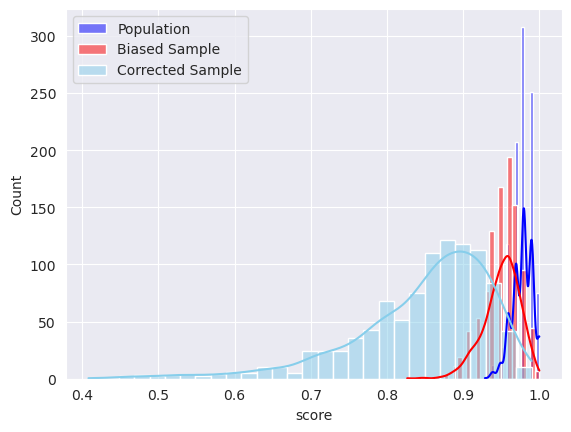

In [118]:
corr_df_5 = correction_experiment(1000, 5.0, xs, ys, pipe_int, alpha_star,intercept=True,)

<AxesSubplot:>

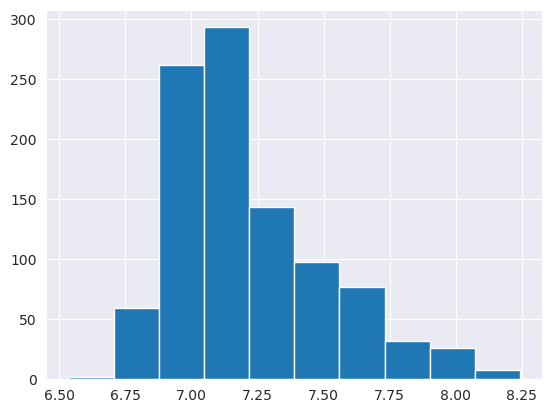

In [91]:
corr_df_5.groupby('trial_num').mean()['population_signal_strength'].hist()

<AxesSubplot:xlabel='population_signal_strength', ylabel='population_score'>

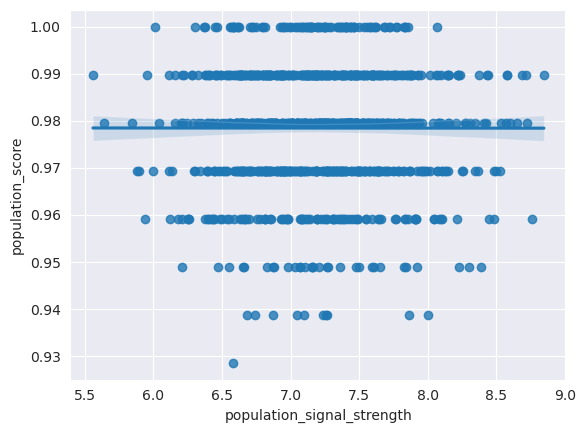

In [112]:
sns.regplot( data=corr_df.groupby('trial_num').mean()
             , x='population_signal_strength'
             , y='population_score')

Text(0.5, 0, 'signal strength')

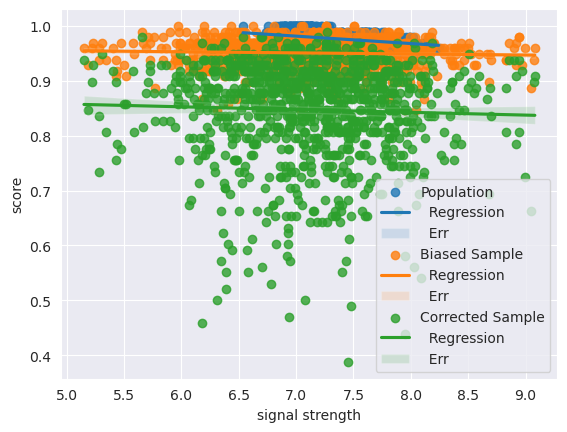

In [111]:
sns.regplot( data=corr_df_5.groupby('trial_num').mean()
             , x='population_signal_strength'
             , y='population_score')
sns.regplot( data=corr_df_5.groupby('trial_num').mean()
             , x='sample_signal_strength'
             , y='sample_score')
sns.regplot( data=corr_df_5.groupby('trial_num').mean()
             , x='sample_signal_strength'
             , y='corrected_score')
plt.legend(['Population', '  Regression', '  Err', 'Biased Sample', '  Regression', '  Err',
            'Corrected Sample',  '  Regression', '  Err',])
plt.ylabel('score')
plt.xlabel('signal strength')

# Let's go even lower

EPV = 2.5

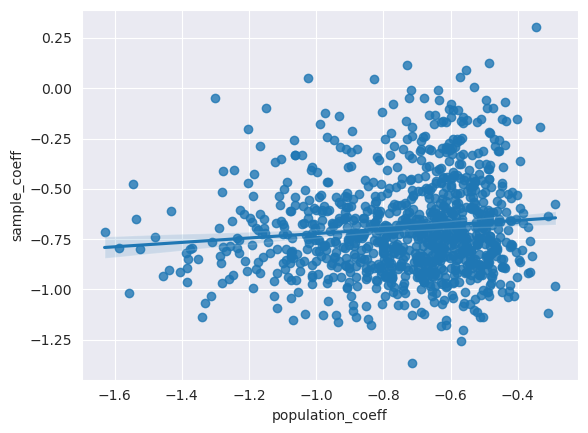

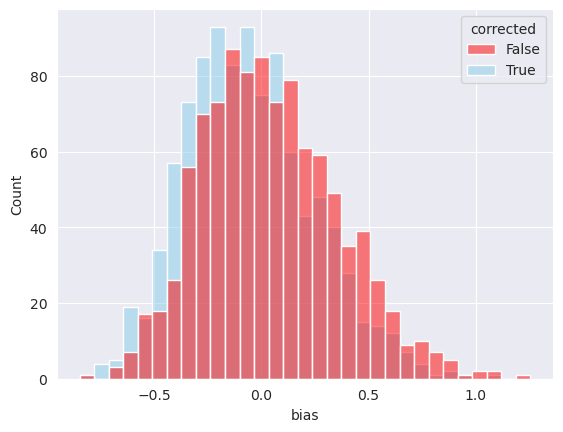

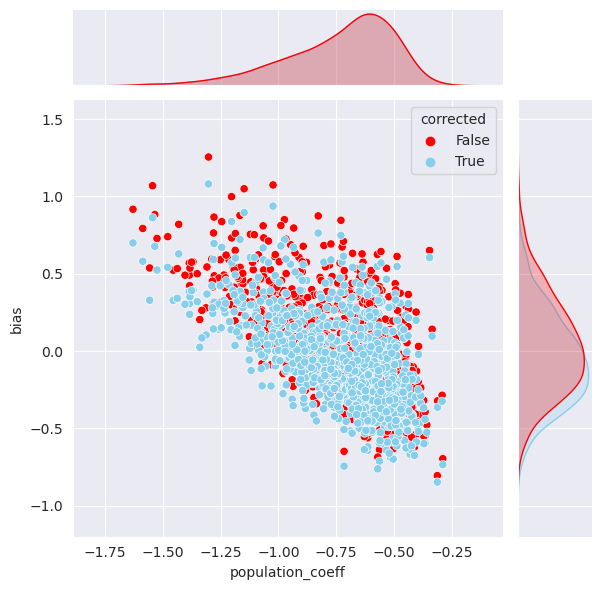

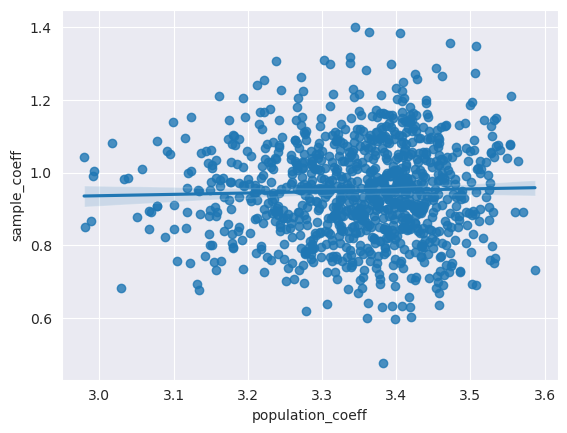

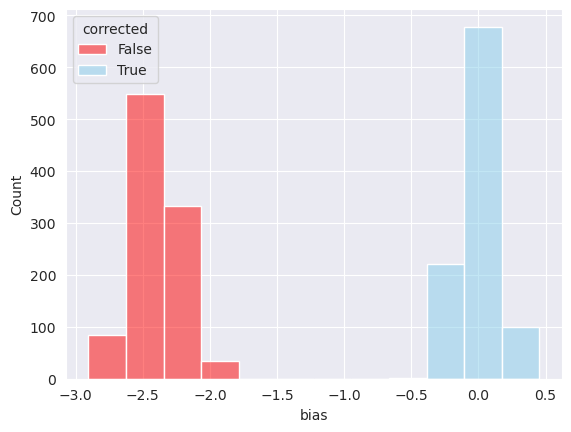

...

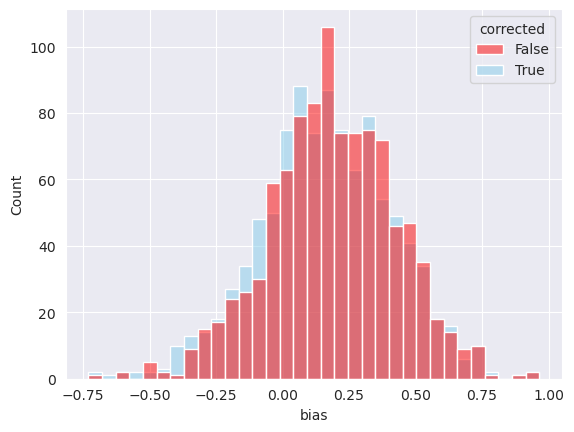

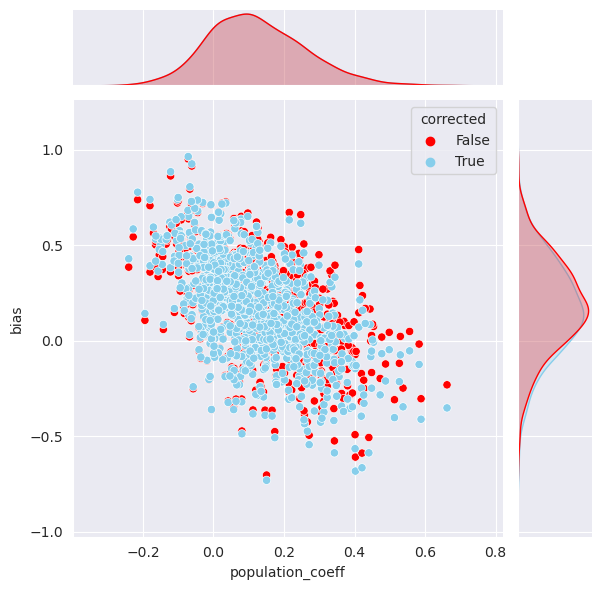

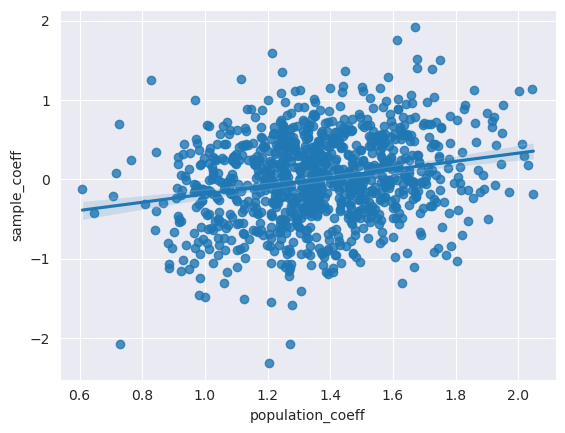

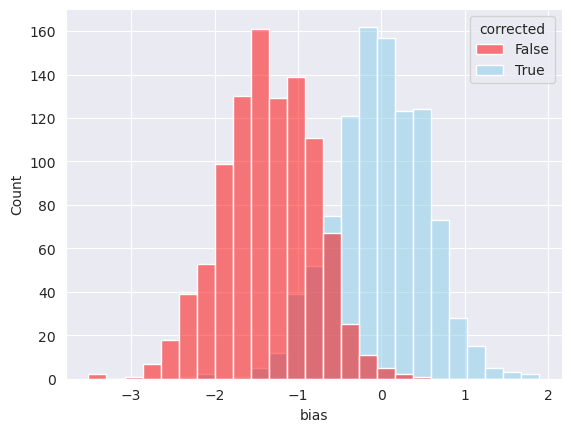

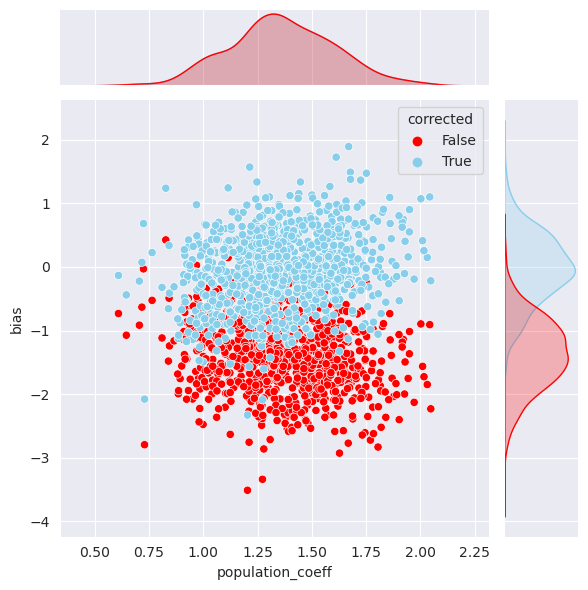

In [119]:
df, alpha_star = experiment(1000, 2.5, xs, ys, pipe_int, seed=12345,intercept=True,)

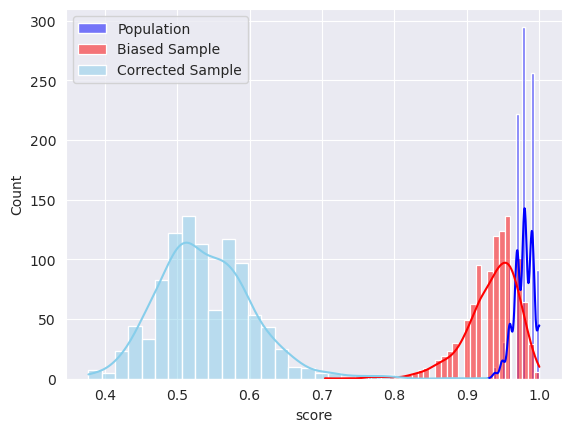

In [120]:
corr_df_2_5 = correction_experiment(1000, 2.5, xs, ys, pipe_int, alpha_star, seed=12345,intercept=True,)

<AxesSubplot:>

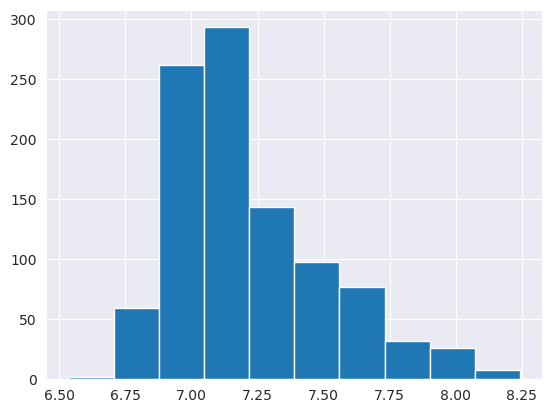

In [121]:
corr_df_2_5.groupby('trial_num').mean()['population_signal_strength'].hist()

Higher? 

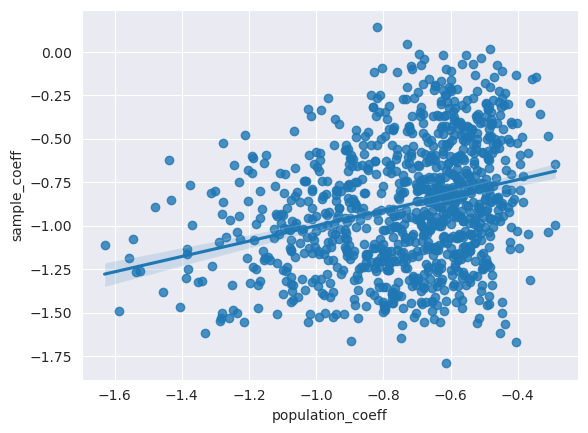

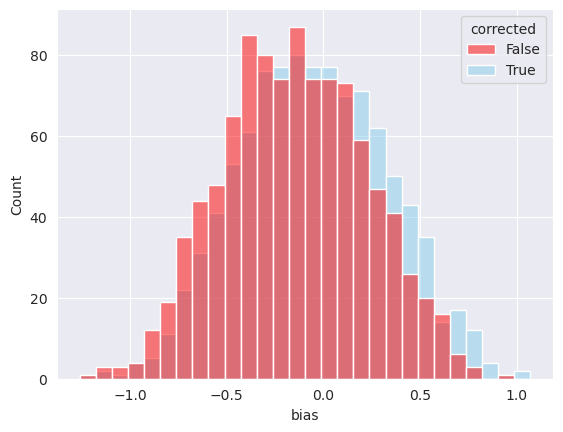

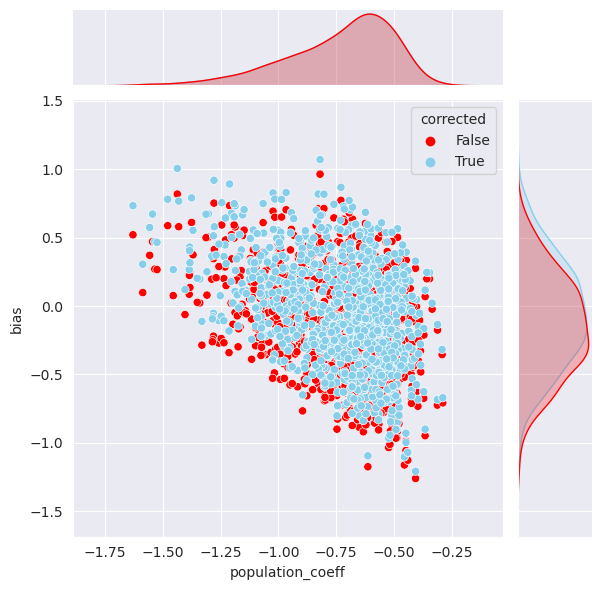

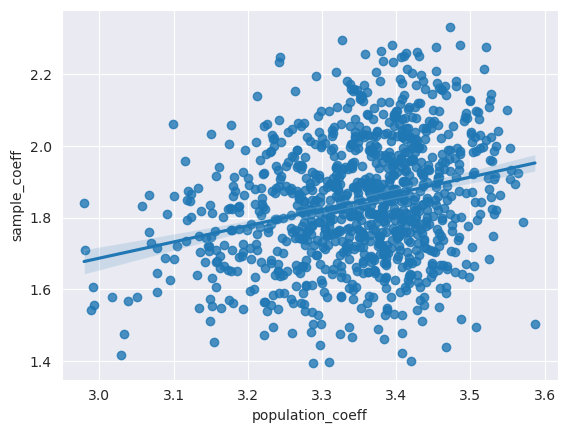

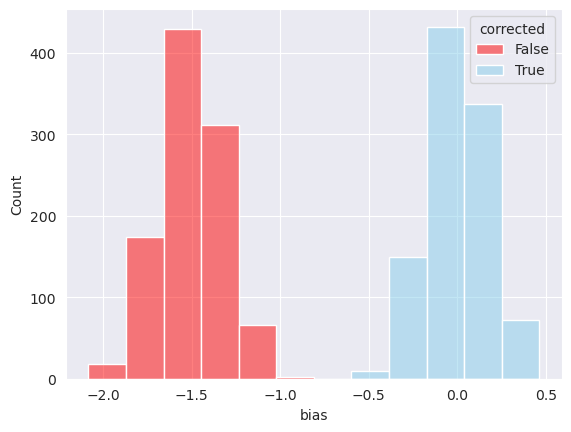

...

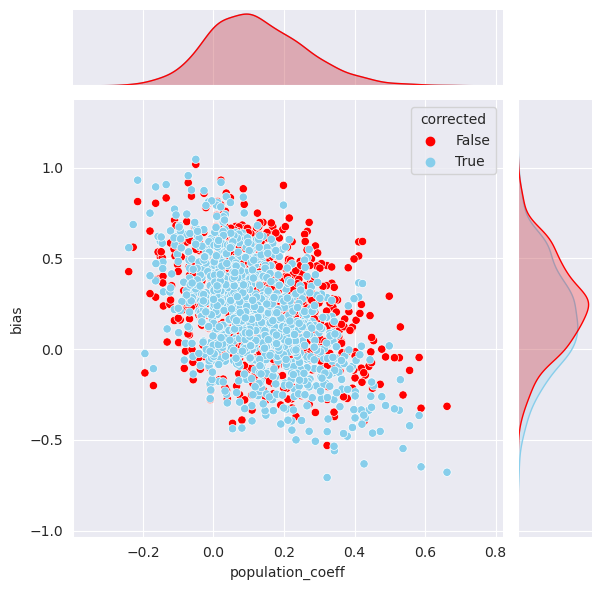

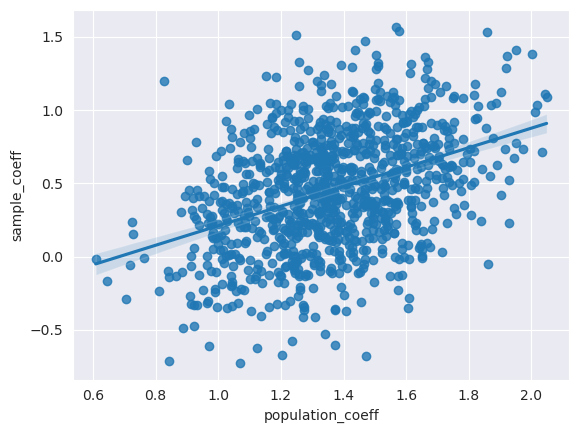

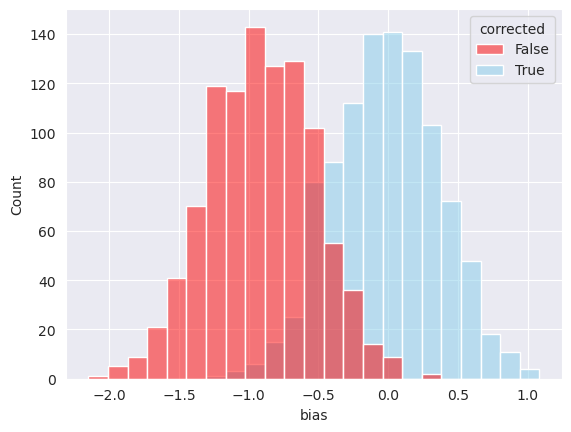

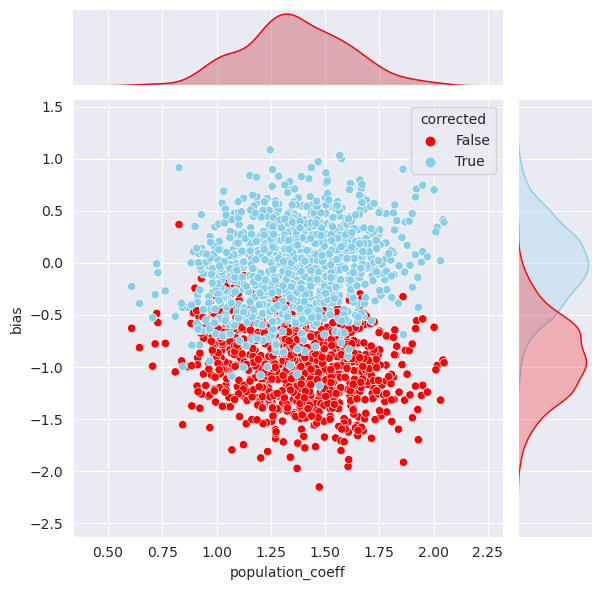

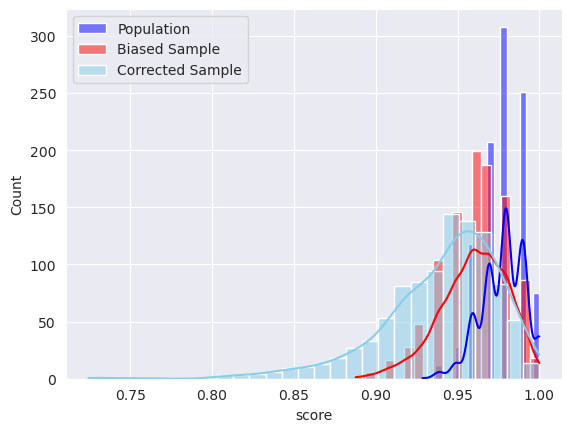

In [122]:
df, alpha_star = experiment(1000, 10, xs, ys, pipe_int, seed=12345,intercept=True,)
corr_df_10 = correction_experiment(1000, 10, xs, ys, pipe_int, alpha_star,intercept=True,)

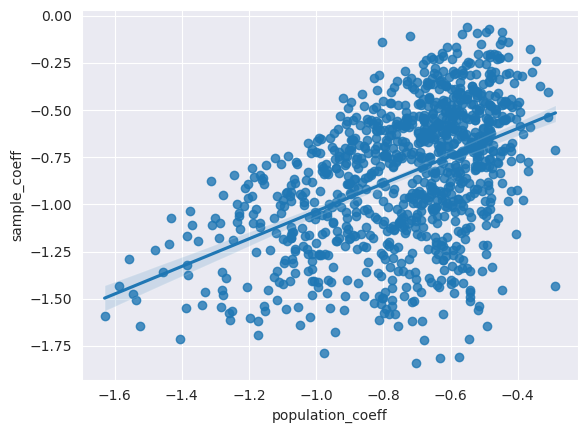

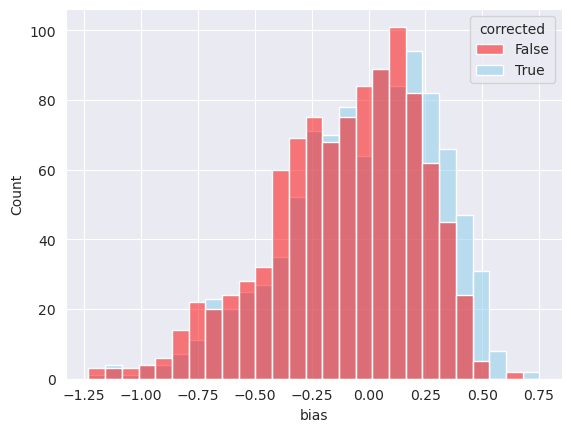

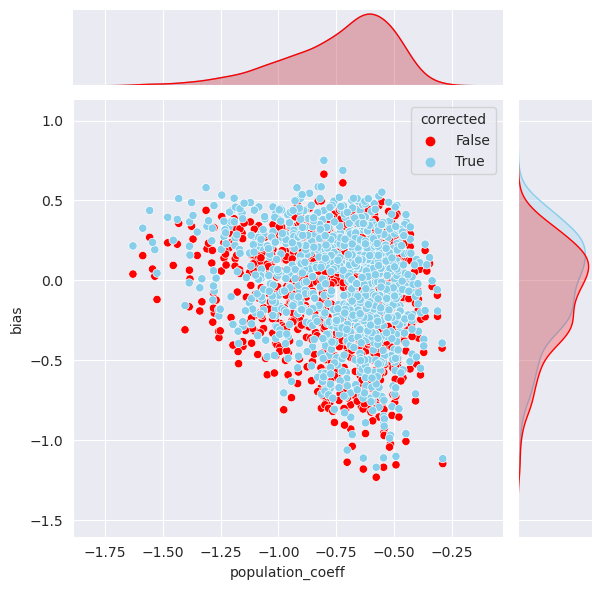

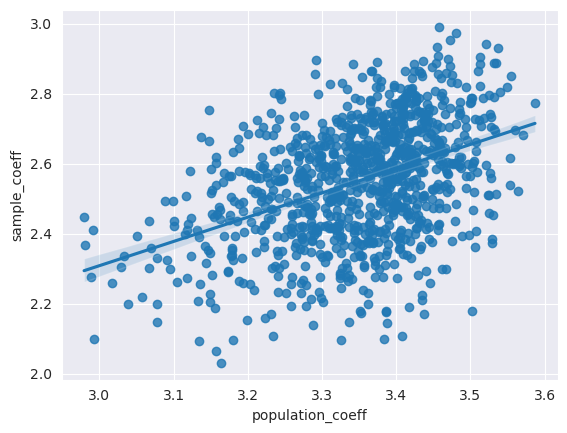

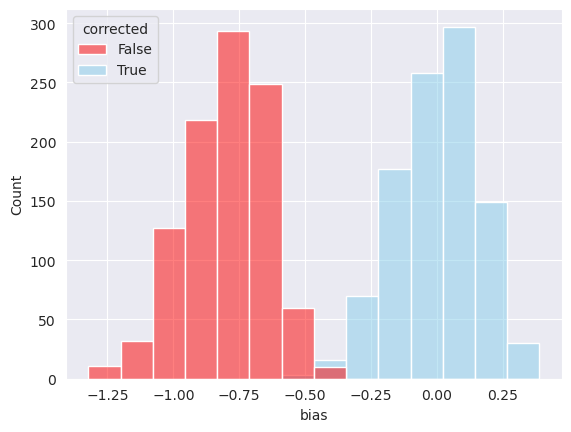

...

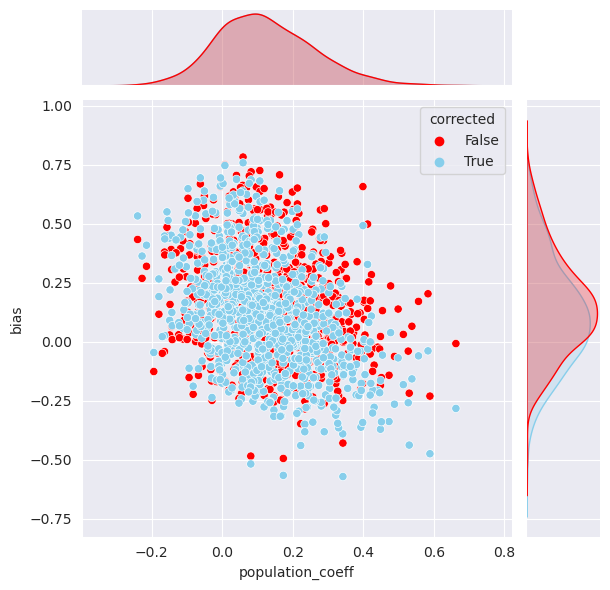

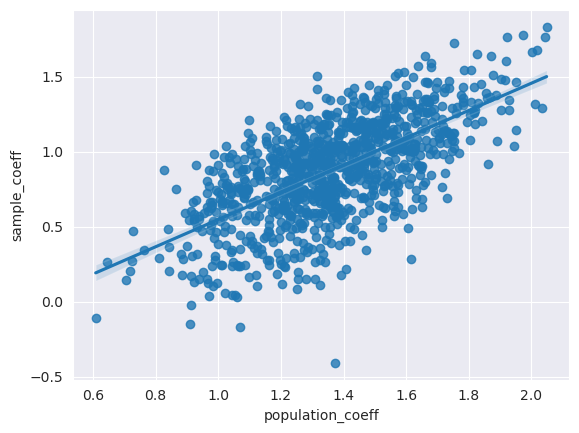

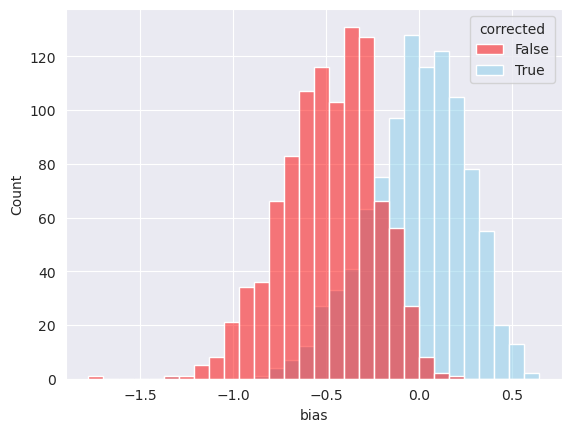

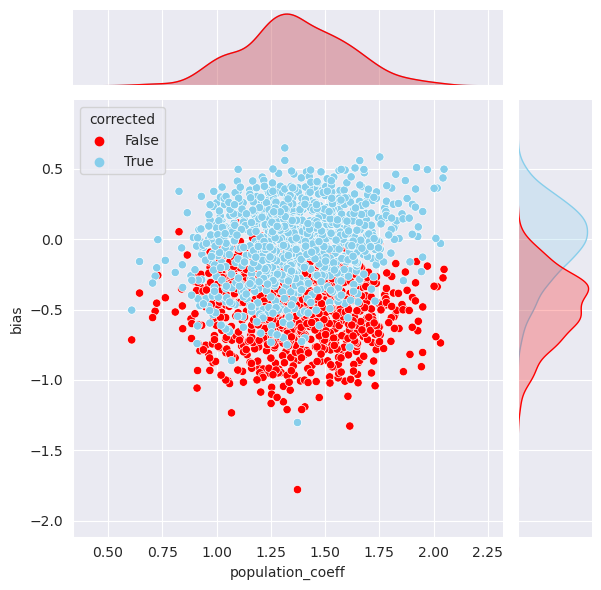

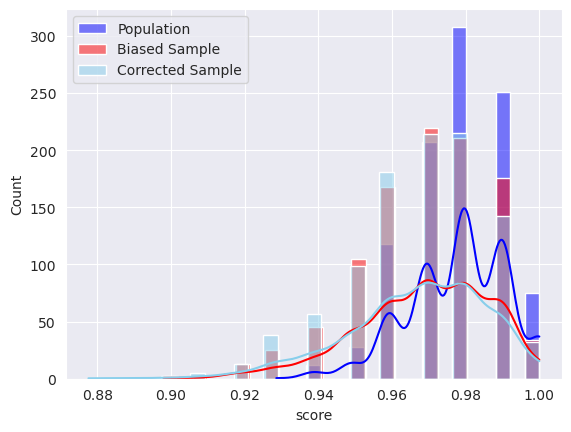

In [123]:
df, alpha_star = experiment(1000, 20, xs, ys, pipe_int, seed=12345,intercept=True,)
corr_df_20 = correction_experiment(1000, 20, xs, ys, pipe_int, alpha_star,intercept=True,)

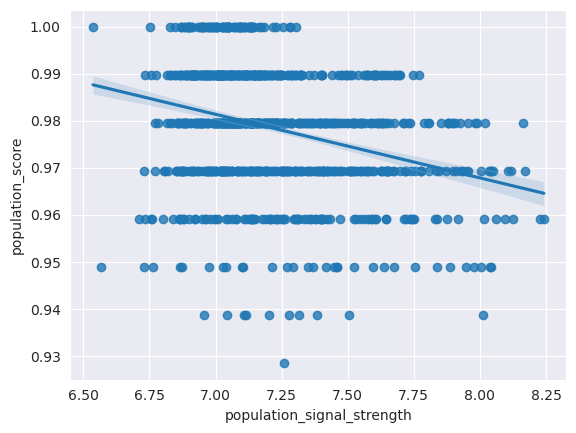

<AxesSubplot:xlabel='sample_signal_strength', ylabel='sample_score'>

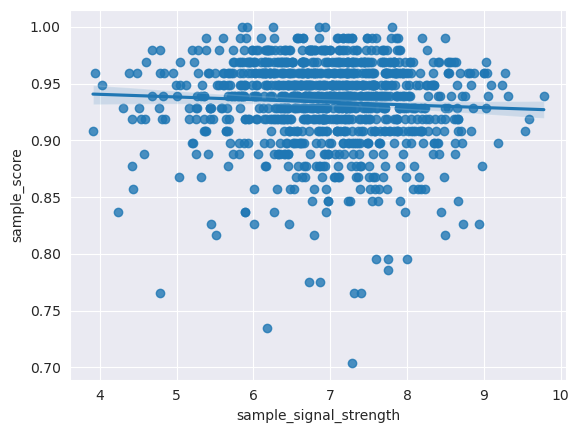

In [128]:
sns.regplot( data=corr_df_2_5.groupby('trial_num').mean()
             , x='population_signal_strength'
             , y='population_score')
plt.show()
sns.regplot( data=corr_df_2_5.groupby('trial_num').mean()
             , x='sample_signal_strength'
             , y='sample_score')

In [230]:
def signal_strength_sample_corr(df):
    lr = LinearRegression().fit(df[['population_signal_strength']], df['sample_score'])
    my_str =  "y = {:.4}x + {:.4}".format(lr.coef_[0], lr.intercept_)
#     plt.text(7.7, 0.705, my_str)
    plt.title(my_str)
    sns.regplot( data=df.groupby('trial_num').mean()
             , x='sample_signal_strength'
             , y='sample_score'
               )

    plt.show()
    return lr.coef_[0], lr.intercept_

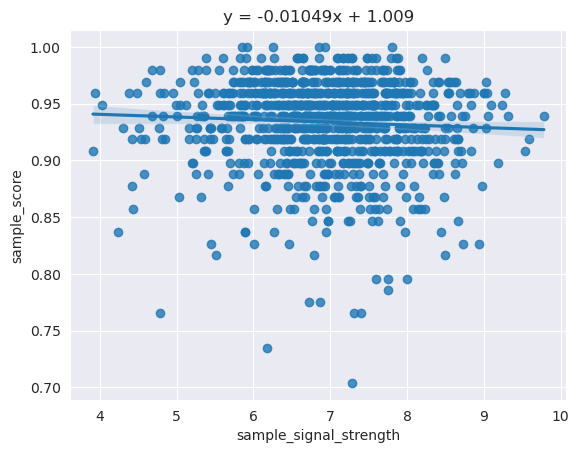

(-0.010490523363950406, 1.0093453228075142)

In [231]:
signal_strength_sample_corr(corr_df_2_5)

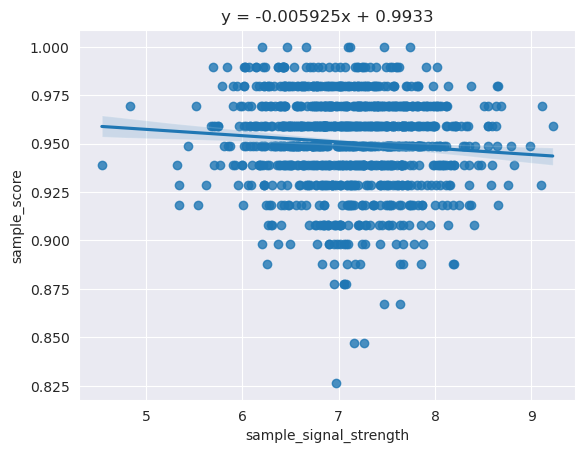

(-0.0059246966813145865, 0.9932979372930362)

In [232]:
signal_strength_sample_corr(corr_df_5)

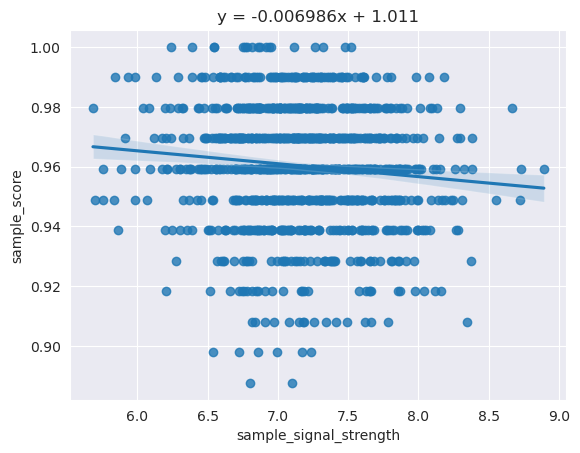

(-0.006986395858473832, 1.0106648156040192)

In [233]:
signal_strength_sample_corr(corr_df_10)

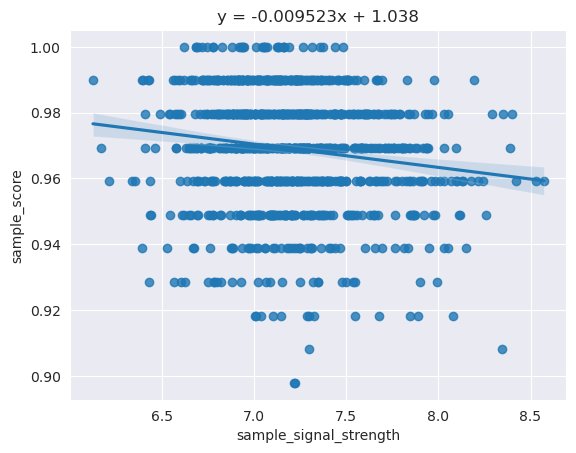

(-0.009523425696637711, 1.037816497661953)

In [234]:
signal_strength_sample_corr(corr_df_20)

Text(0, 0.5, 'Mean Sample Score')

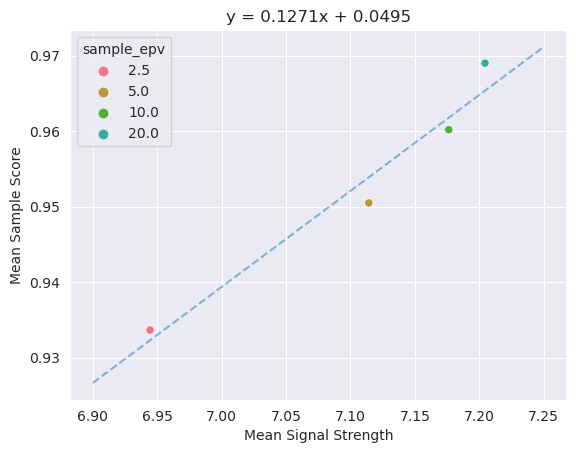

In [264]:
dfs = [corr_df_2_5, corr_df_5, corr_df_10, corr_df_20]
combined = pd.concat([
                    d.groupby(['trial_num']).mean() for d in dfs
                             ]).groupby('sample_epv').mean()
sns.scatterplot( data = combined
           , x='sample_signal_strength'
           , y='sample_score'
           , hue='sample_epv' 
           , palette = sns.color_palette('husl')[:4]
           ) 
lr2 = LinearRegression().fit(combined[['sample_signal_strength']], combined['sample_score'])
sss_xs = np.arange(6.90, 7.30, 0.05)
plt.plot(sss_xs, lr2.coef_[0] * sss_xs + lr2.intercept_, '--', alpha=0.5)
my_str = "y = {:.4}x + {:.4}".format(lr2.coef_[0], lr2.intercept_)
plt.title(my_str)
plt.xlabel('Mean Signal Strength')
plt.ylabel('Mean Sample Score')